In [ ]:
# Clone AnimateDiff repo
!git clone https://github.com/Kyotogod/AnimateDiff-Colab.git
%cd AnimateDiff-Colab

# Install dependencies
!pip install -r requirements.txt

# Download AnimateDiff motion module (already included in notebook below, optional here)
!mkdir -p models/Motion_Module
!wget -P models/Motion_Module https://huggingface.co/guoyww/AnimateDiff/resolve/main/mm_sd_v15_v2.ckpt

# Download Stable Diffusion 1.5 model (anime one recommended)
!mkdir -p models/StableDiffusion
!wget -P models/StableDiffusion https://huggingface.co/runwayml/stable-diffusion-v1-5/resolve/main/model.ckpt


Cloning into 'AnimateDiff-Colab'...
fatal: could not read Username for 'https://github.com': No such device or address
[Errno 2] No such file or directory: 'AnimateDiff-Colab'
/content
ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'
--2025-03-30 03:09:45--  https://huggingface.co/guoyww/AnimateDiff/resolve/main/mm_sd_v15_v2.ckpt
Resolving huggingface.co (huggingface.co)... 18.164.174.17, 18.164.174.23, 18.164.174.55, ...
Connecting to huggingface.co (huggingface.co)|18.164.174.17|:443... connected.
HTTP request sent, awaiting response... 307 Temporary Redirect
Location: /guoyww/animatediff/resolve/main/mm_sd_v15_v2.ckpt [following]
--2025-03-30 03:09:45--  https://huggingface.co/guoyww/animatediff/resolve/main/mm_sd_v15_v2.ckpt
Reusing existing connection to huggingface.co:443.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.hf.co/repos/80/a9/80a9efd8e3732d097f2777edd953760ce288e2370fb8a8bb4803c0f8f29dca40/69e

In [ ]:
# Install ffmpeg if not already installed
!apt-get -y install ffmpeg

# Create the transition video
!ffmpeg -framerate 12 -i frames/frame_%03d.png -c:v libx264 -pix_fmt yuv420p transition.mp4


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq -

In [ ]:
from PIL import Image
import os
start_img_path = "/content/panel.jpg"
end_img_path = "/content/end.png"
start_img = Image.open(start_img_path).resize((512, 512))
end_img = Image.open(end_img_path).resize((512, 512))

def interpolate_images(img1, img2, steps):
    img_seq = []
    for i in range(steps):
        alpha = i / (steps - 1)
        blended = Image.blend(img1, img2, alpha)
        img_seq.append(blended)
    return img_seq

frames = interpolate_images(start_img, end_img, steps=32)

# Save frames
os.makedirs("frames", exist_ok=True)
for i, frame in enumerate(frames):
    frame.save(f"frames/frame_{i:03d}.png")

In [ ]:
!ffmpeg -framerate 32 -i frames/frame_%03d.png -c:v libx264 -pix_fmt yuv420p transition.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
!pip install diffusers transformers accelerate ftfy
!pip install git+https://github.com/openai/CLIP.git
!pip install --upgrade torch torchvision torchaudio

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-4vh71fnm
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-4vh71fnm
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done


In [ ]:
from diffusers import StableDiffusionPipeline
import torch
from PIL import Image
import numpy as np
import os

# Load SD1.5 from HuggingFace
pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to("cuda")

pipe.enable_attention_slicing()


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
def image_to_latent(image_path):
    image = Image.open(image_path).convert("RGB").resize((512, 512))
    image = pipe.feature_extractor(images=image, return_tensors="pt").pixel_values.to("cuda", dtype=torch.float16)
    latents = pipe.vae.encode(image).latent_dist.sample() * 0.2
    return latents

latent_start = image_to_latent("/content/panel.jpg")
latent_end = image_to_latent("/content/end.png")

def interpolate_latents(start, end, steps=32):
    return [(1 - t) * start + t * end for t in np.linspace(0, 1, steps)]

latent_seq = interpolate_latents(latent_start, latent_end, steps=32)



In [ ]:
def latent_to_image(latent):
    latent = latent / 0.18215
    image = pipe.vae.decode(latent).sample
    image = (image / 2 + 0.5).clamp(0, 1)
    # image = image.cpu().permute(0, 2, 3, 1).numpy()[0]
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()[0]

    return (image * 255).astype(np.uint8)

os.makedirs("transition_frames", exist_ok=True)

for i, latent in enumerate(latent_seq):
    img = latent_to_image(latent)
    Image.fromarray(img).save(f"transition_frames/frame_{i:03d}.png")


In [16]:
!rm -rf /content/frames

In [ ]:
!ffmpeg -framerate 16 -i transition_frames/frame_%03d.png -c:v libx264 -pix_fmt yuv420p transition2.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# !pip install git+https://github.com/facebookresearch/dinov2.git
!pip install timm
# This combo works well on Colab with GPU runtime
# ✅ Reset everything to working versions
# !pip uninstall -y torch torchvision torchaudio numpy
!pip install numpy==1.24.3
!pip install torch==2.0.1 torchvision==0.15.2 torchaudio==2.0.2 --index-url https://download.pytorch.org/whl/cu118


Found existing installation: torch 2.0.1+cu118
Uninstalling torch-2.0.1+cu118:
  Successfully uninstalled torch-2.0.1+cu118
Found existing installation: torchvision 0.15.2+cu118
Uninstalling torchvision-0.15.2+cu118:
  Successfully uninstalled torchvision-0.15.2+cu118
Found existing installation: torchaudio 2.0.2+cu118
Uninstalling torchaudio-2.0.2+cu118:
  Successfully uninstalled torchaudio-2.0.2+cu118
Found existing installation: numpy 2.0.2
Uninstalling numpy-2.0.2:
  Successfully uninstalled numpy-2.0.2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 59.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
peft 0.14.0 requires torch>=1.13.0, which is not installed.
sentence-transformers 3.4.1 requires torch>=1.11.0, which is not installed.
accelerate 1.5.2 requires torch>=2.0.0, which is not installed.
fastai 2.7.19 requires torch<2.7

Looking in indexes: https://download.pytorch.org/whl/cu118
  Using cached https://download.pytorch.org/whl/cu118/torch-2.0.1%2Bcu118-cp311-cp311-linux_x86_64.whl (2267.3 MB)
  Using cached https://download.pytorch.org/whl/cu118/torchvision-0.15.2%2Bcu118-cp311-cp311-linux_x86_64.whl (6.1 MB)
  Using cached https://download.pytorch.org/whl/cu118/torchaudio-2.0.2%2Bcu118-cp311-cp311-linux_x86_64.whl (4.4 MB)


In [ ]:
!pip install pillow

In [ ]:
# import torch
from torchvision import transforms
# from PIL import Image
# from dinov2.models import vision_transformer as vits
# from dinov2.data.transforms import make_classification_eval_transform

# # Load DINOv2 base model
# model = vits.vit_base(patch_size=14)
# model.load_state_dict(torch.hub.load_state_dict_from_url(
#     "https://dl.fbaipublicfiles.com/dinov2/dinov2_vitb14_pretrain.pth",
#     map_location="cpu"
# ))

# model.eval().cuda()
import torch

# Load the ViT-B/14 DINOv2 model
dinov2_vitb14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitb14')
model = dinov2_vitb14
model.eval().cuda()
# If you need the model with registers, use:
# dinov2_vitb14_reg = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitb14_reg')


Downloading: "https://github.com/facebookresearch/dinov2/zipball/main" to /root/.cache/torch/hub/main.zip
/root/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xFormers is not available (SwiGLU)")
/root/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/attention.py:33: UserWarning: xFormers is not available (Attention)
  warnings.warn("xFormers is not available (Attention)")
/root/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/block.py:40: UserWarning: xFormers is not available (Block)
  warnings.warn("xFormers is not available (Block)")
Downloading: "https://dl.fbaipublicfiles.com/dinov2/dinov2_vitb14/dinov2_vitb14_pretrain.pth" to /root/.cache/torch/hub/checkpoints/dinov2_vitb14_pretrain.pth
100%|██████████| 330M/330M [00:02<00:00, 140MB/s]


DinoVisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 768, kernel_size=(14, 14), stride=(14, 14))
    (norm): Identity()
  )
  (blocks): ModuleList(
    (0-11): 12 x NestedTensorBlock(
      (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
      (attn): MemEffAttention(
        (qkv): Linear(in_features=768, out_features=2304, bias=True)
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=768, out_features=768, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): LayerScale()
      (drop_path1): Identity()
      (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=768, out_features=3072, bias=True)
        (act): GELU(approximate='none')
        (fc2): Linear(in_features=3072, out_features=768, bias=True)
        (drop): Dropout(p=0.0, inplace=False)
      )
      (ls2): LayerScale()
      (drop_path2): Identity()
    )
  )
  (n

In [ ]:
from PIL import Image
def preprocess(image_path):
    img = Image.open(image_path).convert("RGB")
    transform = transforms.Compose([
        transforms.Resize((518, 518)),  # DINOv2 works best around 518x518
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5]*3, std=[0.5]*3)
    ])
    return transform(img).unsqueeze(0).cuda()

def get_dino_features(image_tensor):
    with torch.no_grad():
        feats = model.forward_features(image_tensor)
        return feats["x_norm_clstoken"]  # CLS token


In [ ]:
# img1 = preprocess("panel.jpg")     # Your manga image
# img2 = preprocess("frame.png")     # Anime frame

feat1 = get_dino_features(img1)
feat2 = get_dino_features(img2)

# Cosine similarity
similarity = torch.nn.functional.cosine_similarity(feat1, feat2).item()
print(f"🧠 DINOv2 Cosine Similarity Score: {similarity:.4f}")


🧠 DINOv2 Cosine Similarity Score: 0.5129


In [4]:
!rm -rf /content/frames
import os
os.makedirs("frames", exist_ok=True)

!ffmpeg -i punch.mp4 -vf fps=4 frames/frame_%04d.png

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-tbh63ee3
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-tbh63ee3
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369490 sha256=638c80207ac6f8b55539feaada8311c5497af80683862b7ea0234fa00f57a373
  Stored in directory: /tmp/pip-ephem-wheel-cache-ry1ilanj/wheels/3f/7c/a4/9b490845988bf7a4db33674d52f709f088f64392063872eb9a
Successfully built clip


In [ ]:
import clip
import torch
from PIL import Image

# device = "cuda" if torch.cuda.is_available() else "cpu"
device = "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

# Load & preprocess images
img1 = preprocess(Image.open("panel.jpg")).unsqueeze(0).to(device)
img2 = preprocess(Image.open("frame.png")).unsqueeze(0).to(device)


In [ ]:
with torch.no_grad():
    feat1 = model.encode_image(img1)
    feat2 = model.encode_image(img2)

    similarity = torch.nn.functional.cosine_similarity(feat1, feat2).item()

print(f"🧠 CLIP Cosine Similarity Score: {similarity:.4f}")


🧠 CLIP Cosine Similarity Score: 0.7968


In [ ]:
!pip install open-clip-torch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 36.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 97.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 85.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 830.8 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 94.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12


In [ ]:
import open_clip
import torch
from PIL import Image
from torchvision import transforms

device = "cuda" if torch.cuda.is_available() else "cpu"

# Load pretrained OpenCLIP model (ViT-B/32 trained on LAION-2B)
model, _, preprocess = open_clip.create_model_and_transforms(
    'ViT-B-32', pretrained='laion2b_s34b_b79k'
)
model.to(device)
model.eval()


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (patch_dropout): Identity()
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): ModuleList(
        (0-11): 12 x ResidualAttentionBlock(
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ls_1): Identity()
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): GELU(approximate='none')
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ls_2): Identity()
        )
      )
    )
    (ln_post): LayerNorm((768,), eps=1e-05, elementwise_affine

In [ ]:
def load_image(path):
    img = Image.open(path).convert("RGB")
    return preprocess(img).unsqueeze(0).to(device)

# Load your images
img1 = load_image("panel.jpg")
img2 = load_image("frame.png")

# Encode with OpenCLIP
with torch.no_grad():
    feat1 = model.encode_image(img1)
    feat2 = model.encode_image(img2)
    similarity = torch.nn.functional.cosine_similarity(feat1, feat2).item()

print(f"🔍 OpenCLIP Cosine Similarity Score: {similarity:.4f}")


🔍 OpenCLIP Cosine Similarity Score: 0.6460


In [ ]:
def load_image_grayscale(path):
    img = Image.open(path).convert("L")  # Convert to grayscale
    img = img.convert("RGB")             # Convert back to RGB (for model input shape)
    return preprocess(img).unsqueeze(0).to(device)


In [ ]:
img1 = load_image("panel.jpg")             # manga panel
img2 = load_image_grayscale("frame.png")   # anime frame (now B&W)

with torch.no_grad():
    feat1 = model.encode_image(img1)
    feat2 = model.encode_image(img2)
    similarity = torch.nn.functional.cosine_similarity(feat1, feat2).item()

print(f"🖤 Grayscale OpenCLIP Similarity Score: {similarity:.4f}")


AttributeError: 'Image' object has no attribute 'read'

In [32]:
# !pip install ftfy regex tqdm
# !pip install git+https://github.com/openai/CLIP.git
import clip
import torch
from PIL import Image
import os
from torchvision import transforms

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)
query_image = preprocess(Image.open("panel.jpg").convert("RGB")).unsqueeze(0).to(device)
with torch.no_grad():
    query_embedding = model.encode_image(query_image)


In [33]:
import glob

frame_folder = "frames"  # or "/content/drive/MyDrive/your_folder"
frame_files = sorted(glob.glob(f"{frame_folder}/*.png"))
top_matches = []

for f in frame_files:
    try:
        frame_img = preprocess(Image.open(f).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            frame_embed = model.encode_image(frame_img)
            sim = torch.nn.functional.cosine_similarity(query_embedding, frame_embed).item()
            top_matches.append((f, sim))
    except:
        continue

top_matches.sort(key=lambda x: -x[1])  # Highest score first

# Show top 3
for fname, score in top_matches[:3]:
    print(f"✅ Frame: {fname}, Similarity: {score:.4f}")


✅ Frame: frames/frame_0776.png, Similarity: 0.7939
✅ Frame: frames/frame_0775.png, Similarity: 0.7930
✅ Frame: frames/frame_0778.png, Similarity: 0.7876


🎯 Best Match:


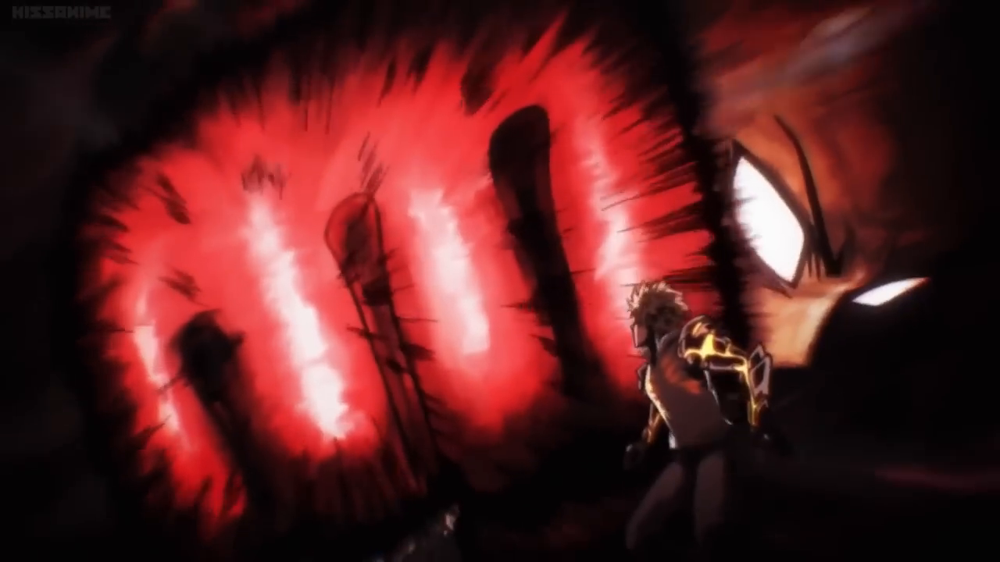

In [34]:
from IPython.display import display

print("🎯 Best Match:")
display(Image.open(top_matches[0][0]))


🎯 Top 10 Matches:

1. Frame: frames/frame_0776.png, Similarity: 0.7939


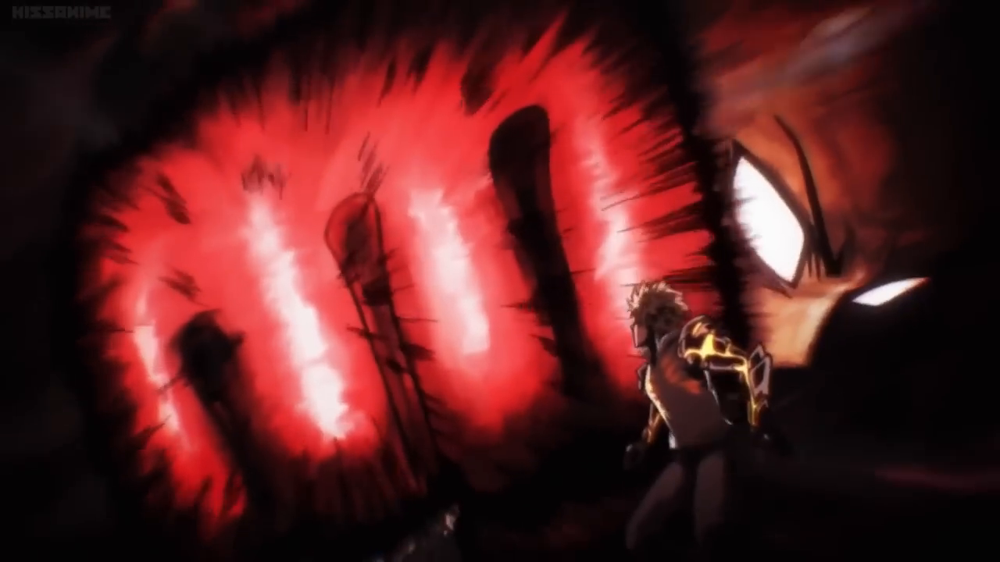

2. Frame: frames/frame_0775.png, Similarity: 0.7930


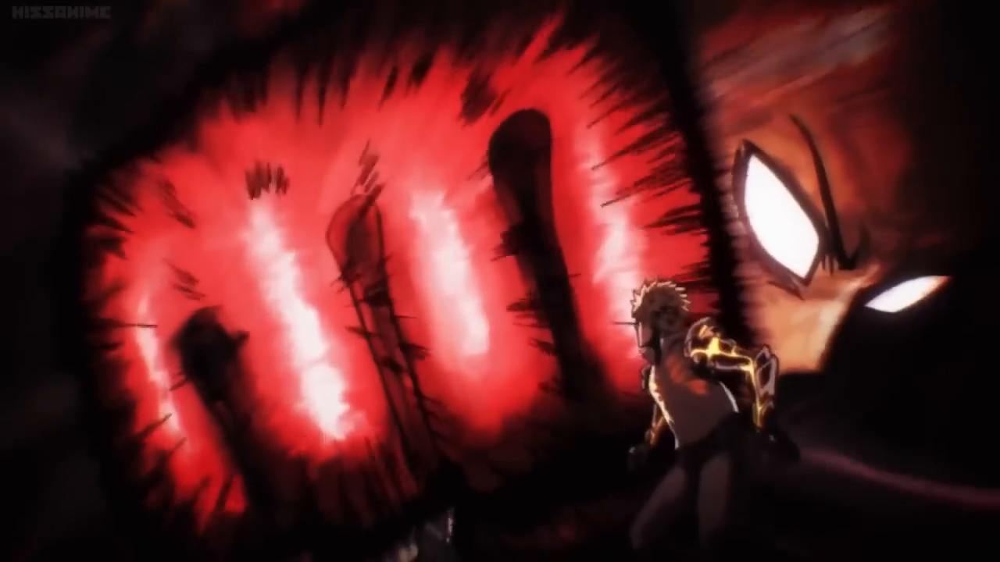

3. Frame: frames/frame_0778.png, Similarity: 0.7876


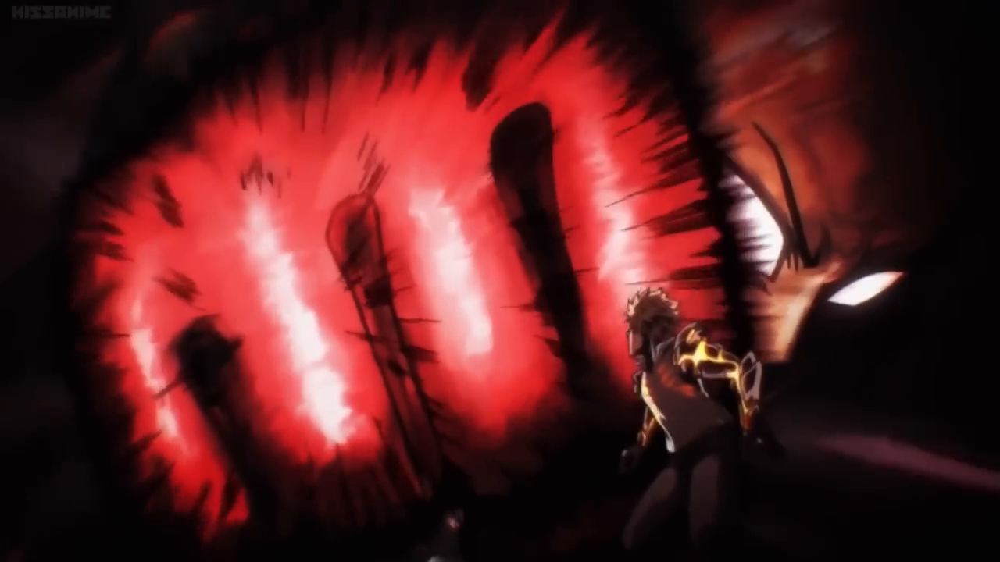

4. Frame: frames/frame_0777.png, Similarity: 0.7871


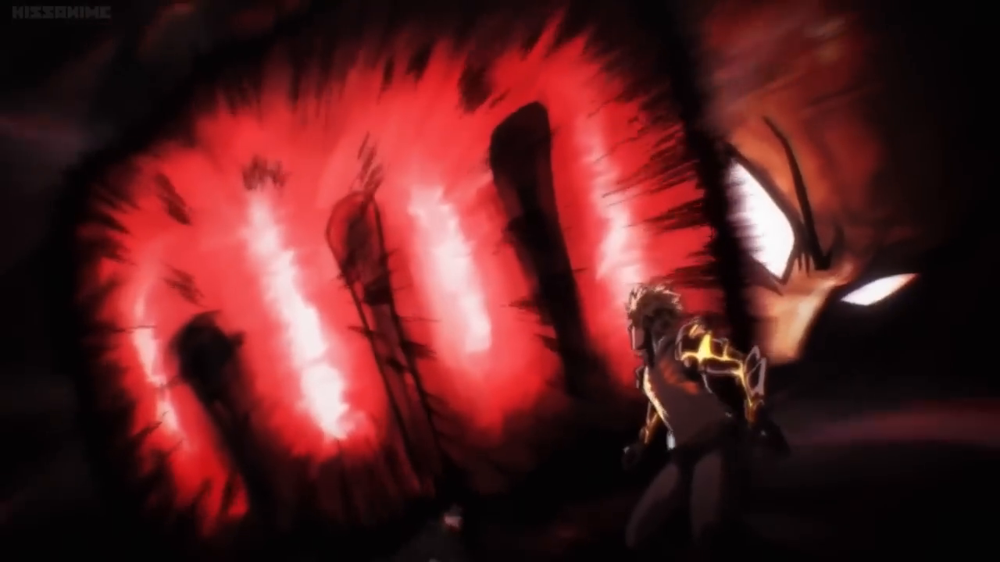

5. Frame: frames/frame_0779.png, Similarity: 0.7871


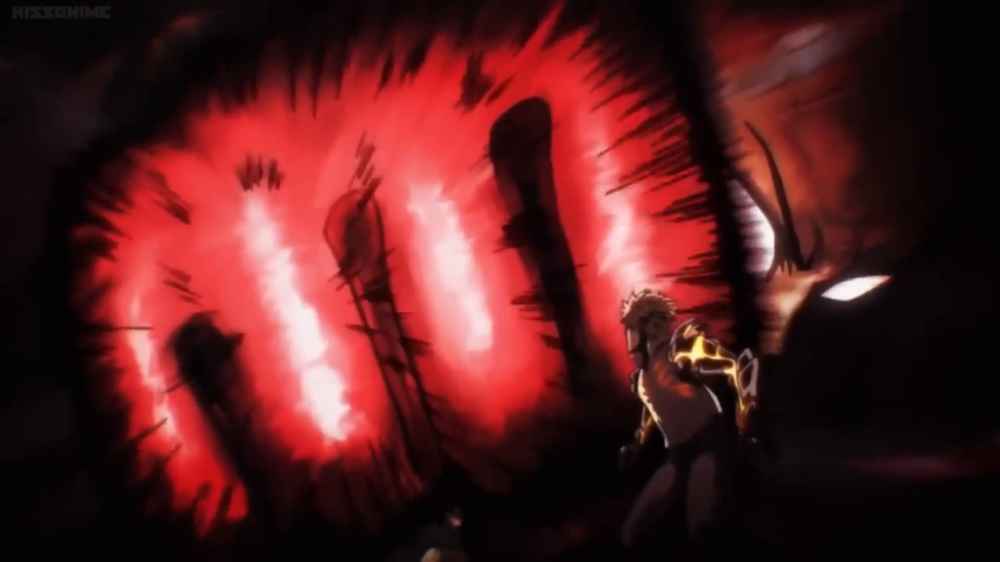

6. Frame: frames/frame_0780.png, Similarity: 0.7822


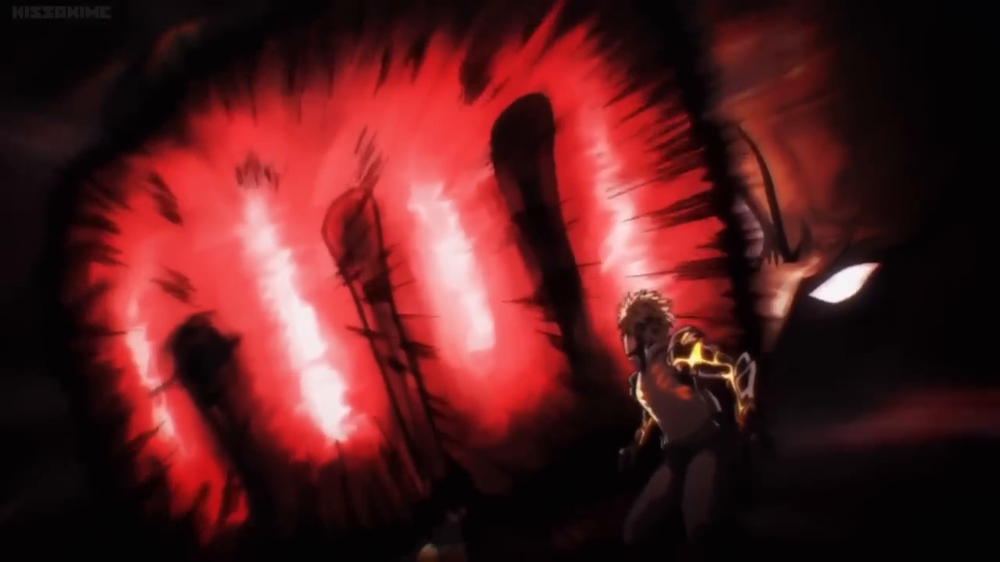

7. Frame: frames/frame_0202.png, Similarity: 0.7798


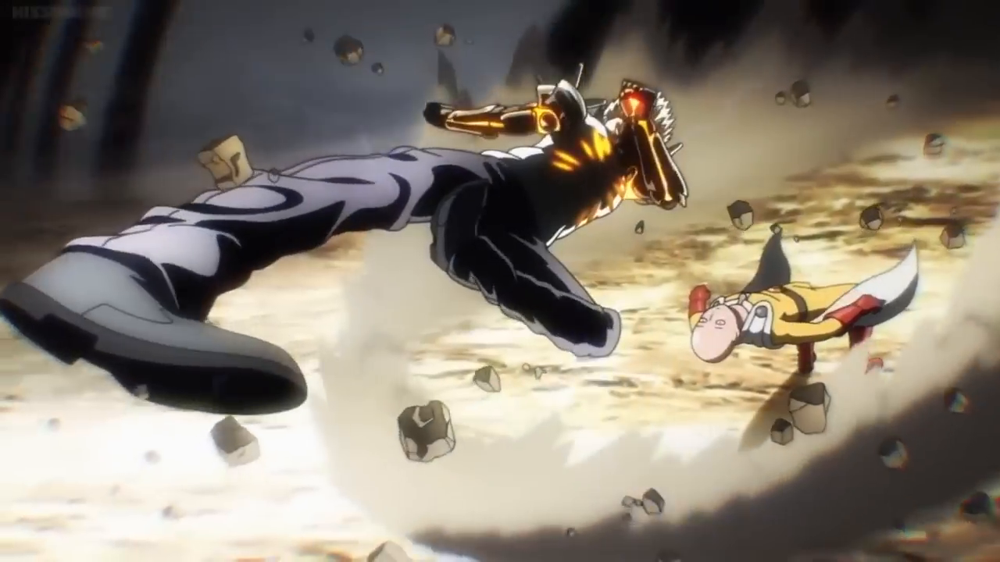

8. Frame: frames/frame_0201.png, Similarity: 0.7769


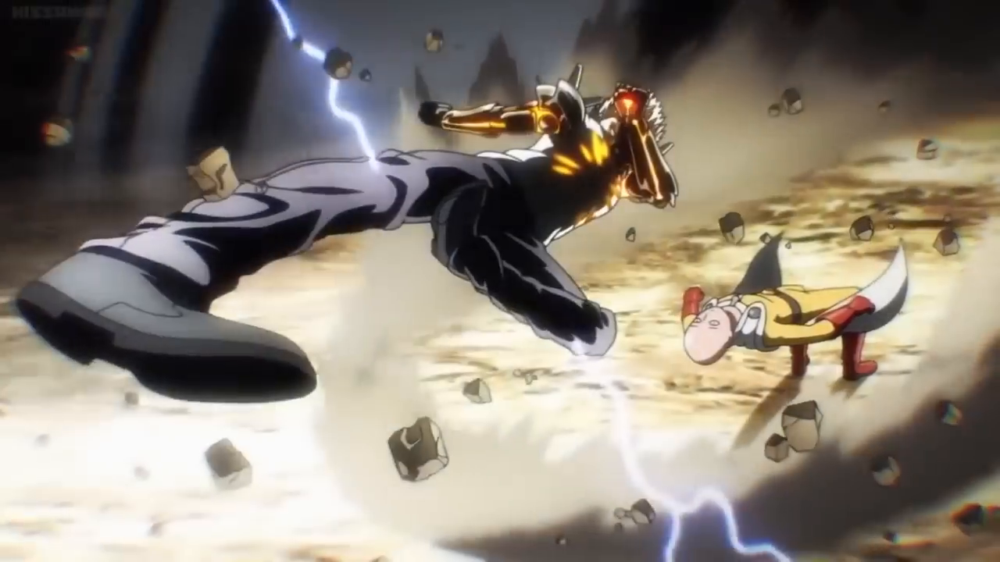

9. Frame: frames/frame_0774.png, Similarity: 0.7734


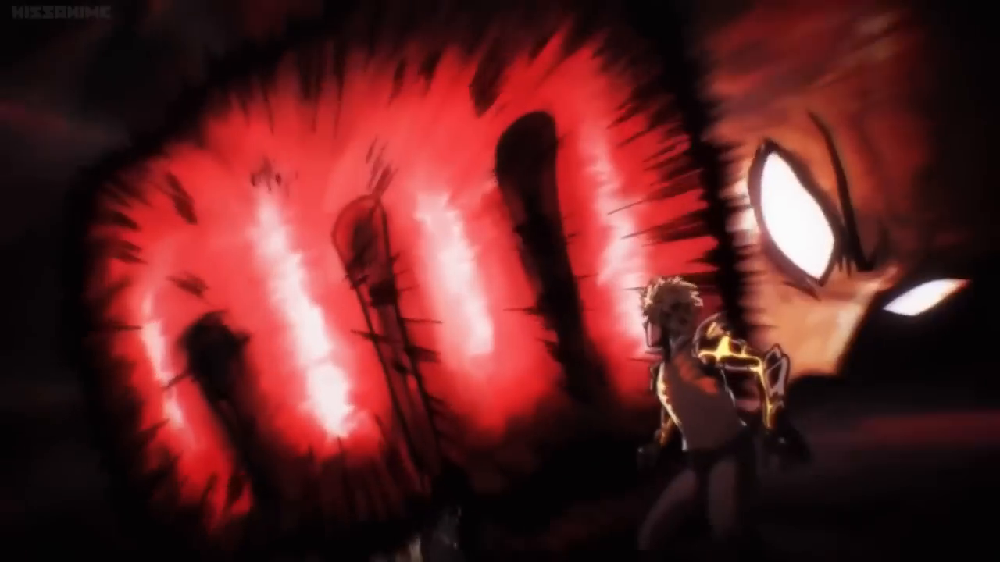

10. Frame: frames/frame_0191.png, Similarity: 0.7661


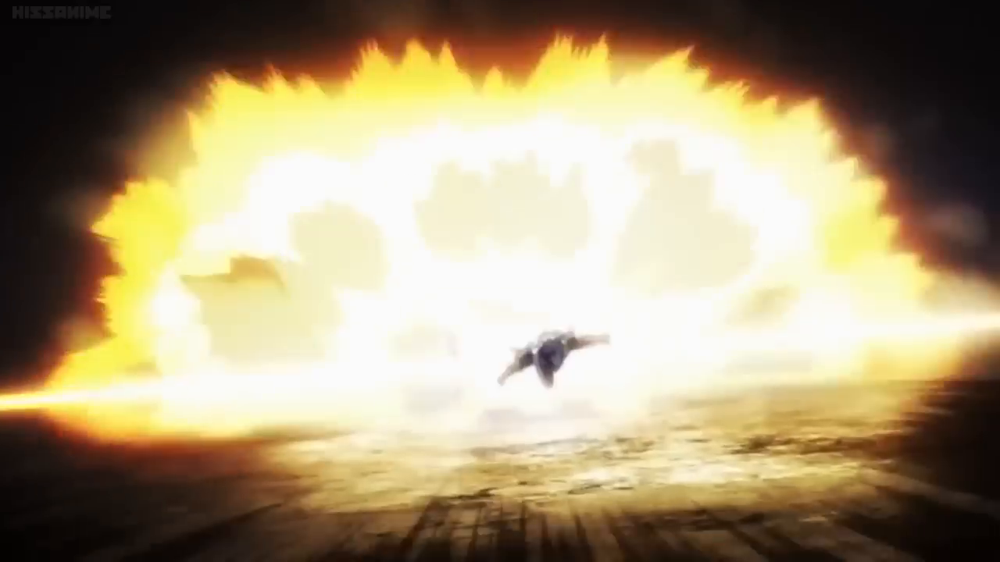

In [35]:
from IPython.display import display
from PIL import Image

print("🎯 Top 10 Matches:\n")

for i, (fname, score) in enumerate(top_matches[:10]):
    print(f"{i+1}. Frame: {fname}, Similarity: {score:.4f}")
    display(Image.open(fname))


In [36]:
# !pip install git+https://github.com/facebookresearch/dinov2.git
# !pip install timm
import torch
from PIL import Image
from torchvision import transforms
# from dinov2.models import vision_transformer as vits

# Load the ViT-B/14 DINOv2 model

import os, glob

device = "cuda" if torch.cuda.is_available() else "cpu"

# Load DINOv2 Base
# model = vits.vit_base()
# state_dict = torch.hub.load_state_dict_from_url(
#     "https://dl.fbaipublicfiles.com/dinov2/dinov2_vitb14_pretrain.pth",
#     map_location=device
# )
# model.load_state_dict(state_dict)
# model.eval().to(device)

# DINOv2 transform
dinov2_vitb14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitb14')
model = dinov2_vitb14
model.eval().cuda()

dino_preprocess = transforms.Compose([
    transforms.Resize((518, 518)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])
query_img = dino_preprocess(Image.open("panel.jpg").convert("RGB")).unsqueeze(0).to(device)

with torch.no_grad():
    query_feat = model.forward_features(query_img)["x_norm_clstoken"]
frame_dir = "frames"  # folder with extracted video frames
frame_files = sorted(glob.glob(f"{frame_dir}/*.png"))

results = []

for path in frame_files:
    try:
        img = dino_preprocess(Image.open(path).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            feat = model.forward_features(img)["x_norm_clstoken"]
            sim = torch.nn.functional.cosine_similarity(query_feat, feat).item()
            results.append((path, sim))
    except:
        continue

# Sort by similarity
results.sort(key=lambda x: -x[1])


Using cache found in /root/.cache/torch/hub/facebookresearch_dinov2_main


🔍 DINOv2 Top 10 Frame Matches:

1. frames/frame_0216.png → Similarity: 0.6348


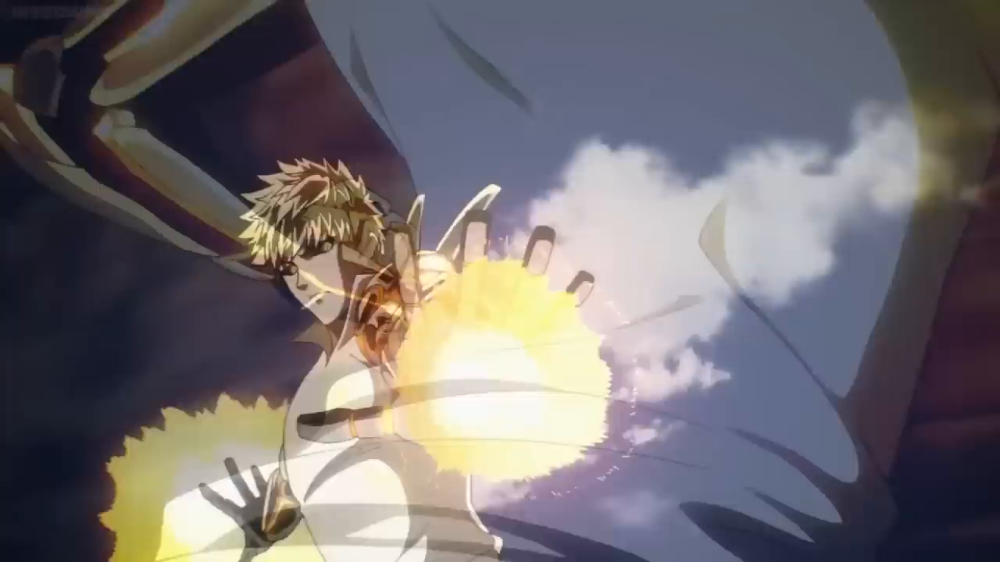

2. frames/frame_0777.png → Similarity: 0.6121


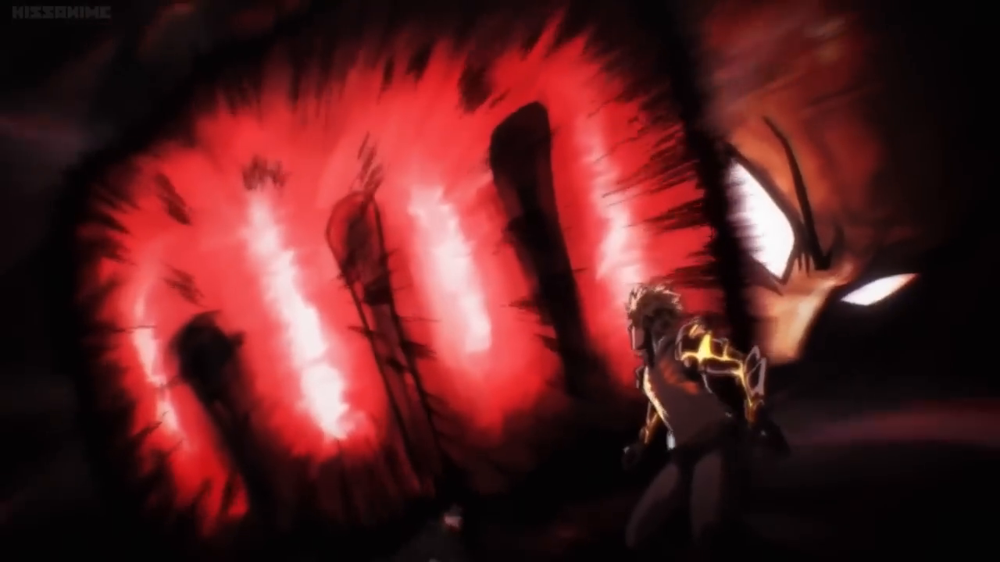

3. frames/frame_0213.png → Similarity: 0.5935


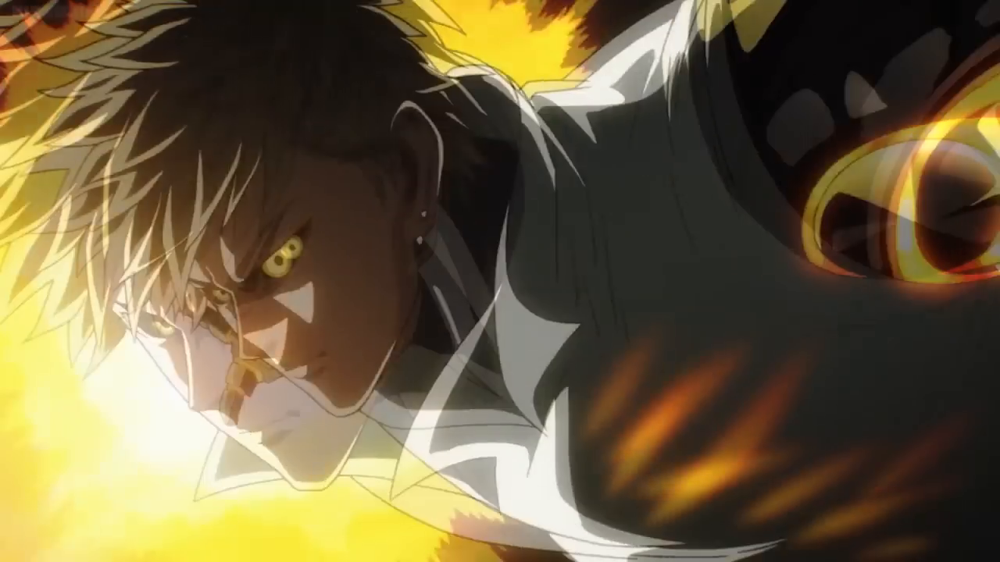

4. frames/frame_0775.png → Similarity: 0.5920


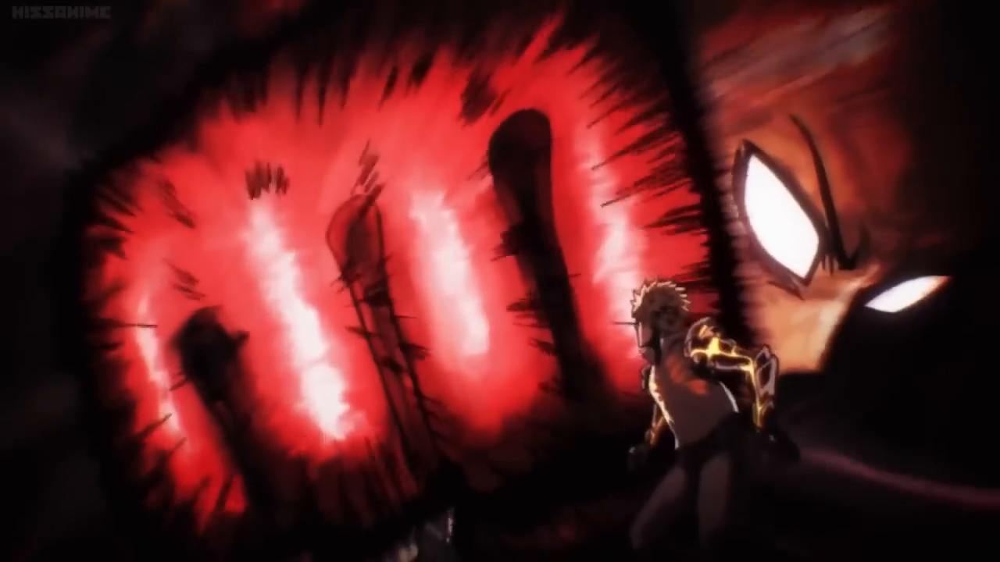

5. frames/frame_0779.png → Similarity: 0.5898


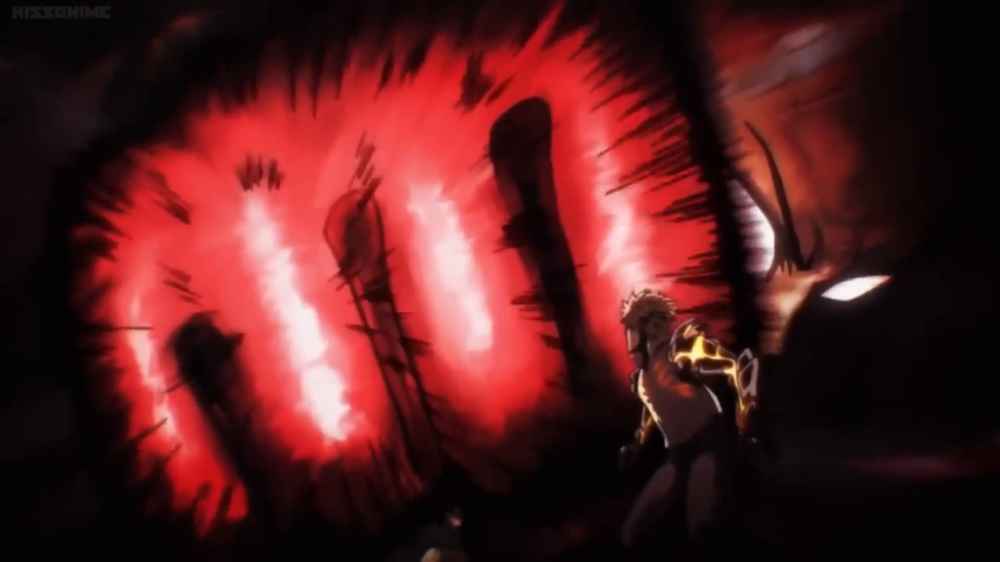

6. frames/frame_0212.png → Similarity: 0.5897


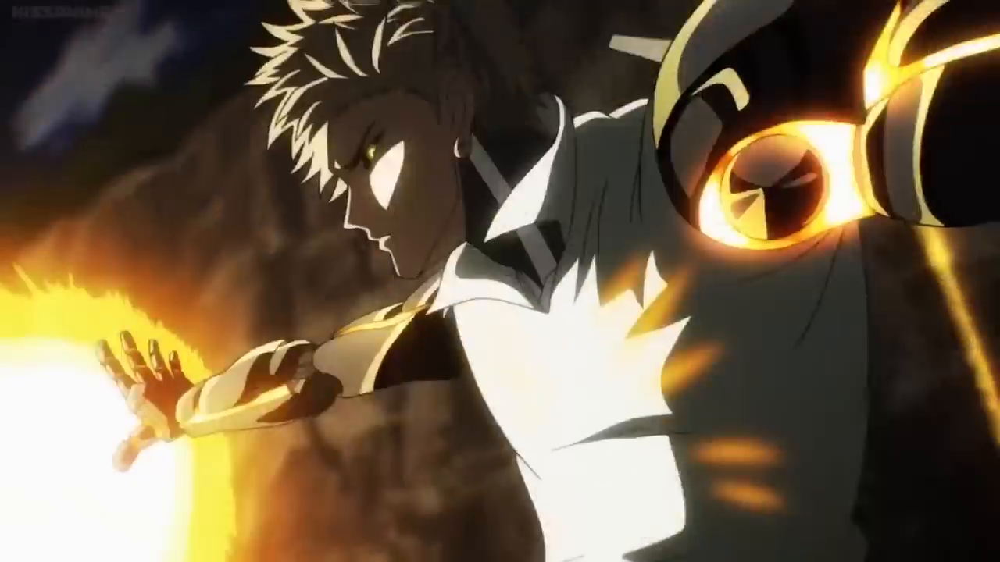

7. frames/frame_0435.png → Similarity: 0.5835


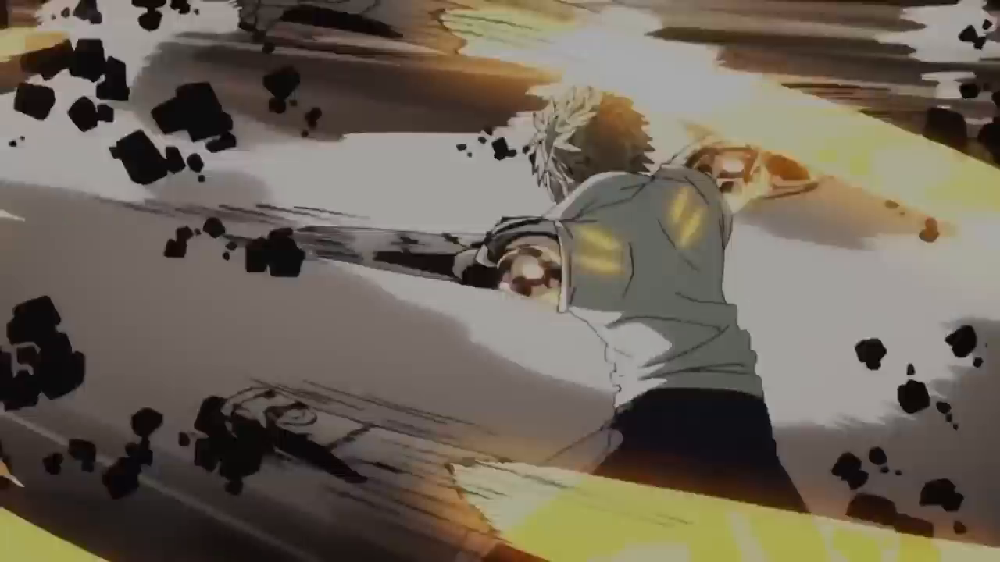

8. frames/frame_0570.png → Similarity: 0.5816


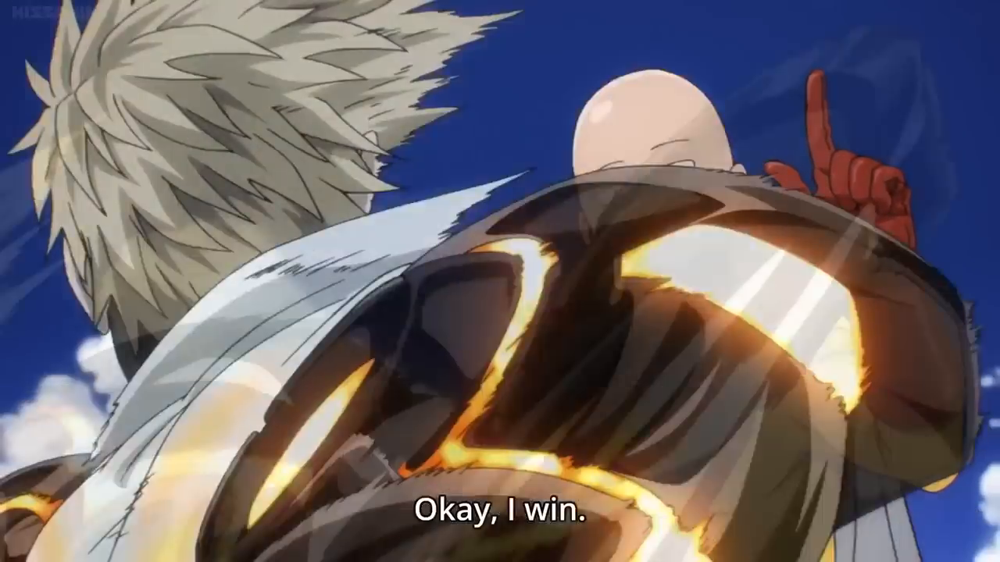

9. frames/frame_0776.png → Similarity: 0.5794


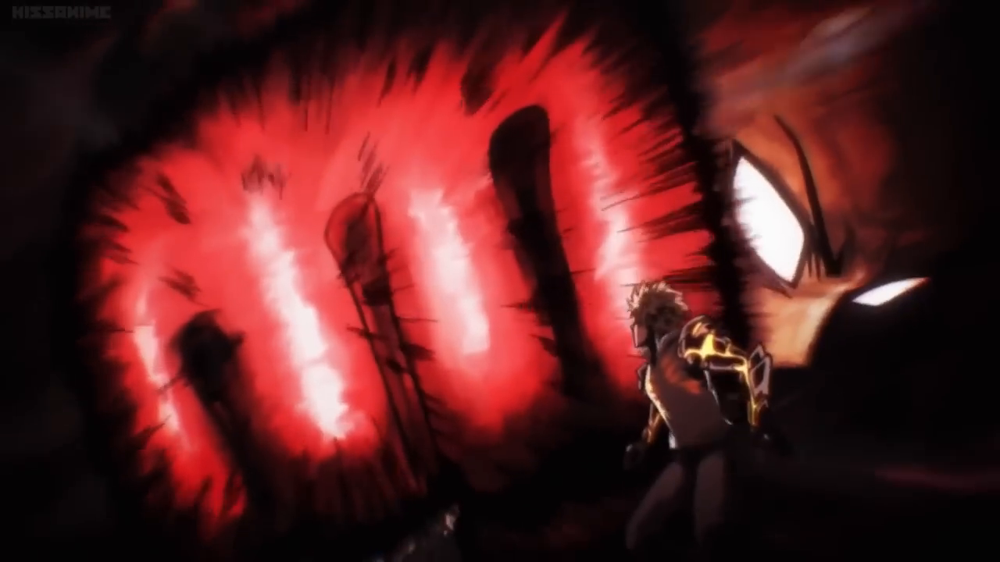

10. frames/frame_0763.png → Similarity: 0.5695


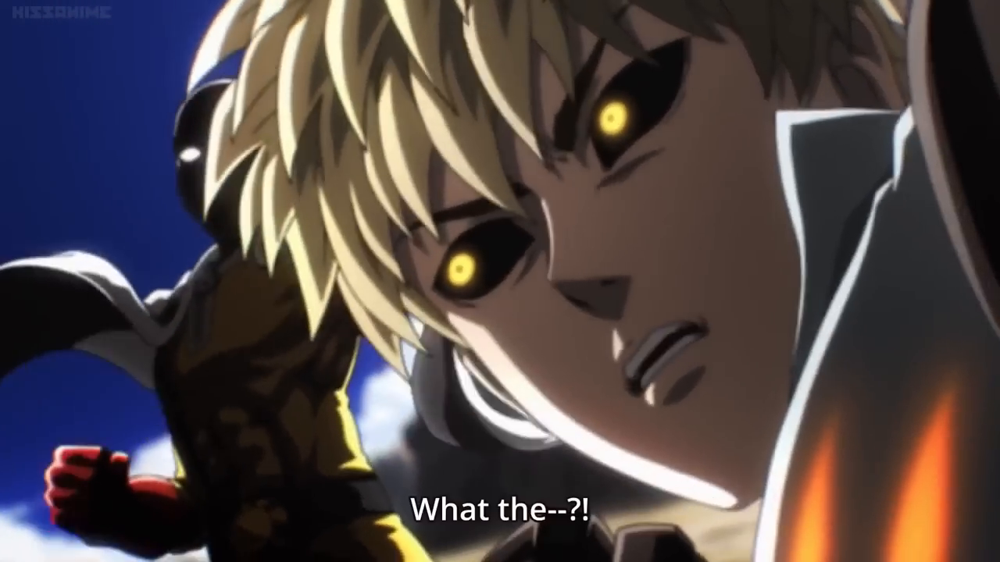

In [37]:
from IPython.display import display

print("🔍 DINOv2 Top 10 Frame Matches:\n")
for i, (fname, score) in enumerate(results[:10]):
    print(f"{i+1}. {fname} → Similarity: {score:.4f}")
    display(Image.open(fname))


In [10]:
import os
import requests
from bs4 import BeautifulSoup

chapter_url = "https://w58.sololevelingthemanga.com/manga/solo-leveling-chapter-9/"
chapter_url = "https://w58.sololevelingthemanga.com/manga/solo-leveling-chapter-6/"
save_dir = "solo_level_6"

os.makedirs(save_dir, exist_ok=True)
headers = {"User-Agent": "Mozilla/5.0"}

response = requests.get(chapter_url, headers=headers)
soup = BeautifulSoup(response.content, "html.parser")

main = soup.find("main")
article = main.find("article") if main else None
wrapper_divs = article.find_all("div") if article else []

img_links = []
for div in wrapper_divs:
    p_tags = div.find_all("p")
    for p in p_tags:
        img = p.find("img")
        if img and img.get("src"):
            img_links.append(img.get("src"))

for i, url in enumerate(img_links):
    try:
        img_data = requests.get(url, headers=headers).content
        filename = os.path.join(save_dir, f"page_{i+1:03}.jpg")
        with open(filename, "wb") as f:
            f.write(img_data)
        print(f"✅ Saved: {filename}")
    except Exception as e:
        print(f"❌ Failed to download {url}: {e}")

print(f"\n📦 Done! {len(img_links)} images downloaded to: {save_dir}")


✅ Saved: solo_level_6/page_001.jpg
✅ Saved: solo_level_6/page_002.jpg
✅ Saved: solo_level_6/page_003.jpg
✅ Saved: solo_level_6/page_004.jpg
✅ Saved: solo_level_6/page_005.jpg
✅ Saved: solo_level_6/page_006.jpg
✅ Saved: solo_level_6/page_007.jpg
✅ Saved: solo_level_6/page_008.jpg
✅ Saved: solo_level_6/page_009.jpg
✅ Saved: solo_level_6/page_010.jpg
✅ Saved: solo_level_6/page_011.jpg
✅ Saved: solo_level_6/page_012.jpg
✅ Saved: solo_level_6/page_013.jpg
✅ Saved: solo_level_6/page_014.jpg
✅ Saved: solo_level_6/page_015.jpg
✅ Saved: solo_level_6/page_016.jpg
✅ Saved: solo_level_6/page_017.jpg
✅ Saved: solo_level_6/page_018.jpg
✅ Saved: solo_level_6/page_019.jpg
✅ Saved: solo_level_6/page_020.jpg
✅ Saved: solo_level_6/page_021.jpg
✅ Saved: solo_level_6/page_022.jpg
✅ Saved: solo_level_6/page_023.jpg
✅ Saved: solo_level_6/page_024.jpg
✅ Saved: solo_level_6/page_025.jpg
✅ Saved: solo_level_6/page_026.jpg
✅ Saved: solo_level_6/page_027.jpg
✅ Saved: solo_level_6/page_028.jpg
✅ Saved: solo_level_

In [1]:
import os
import requests
from bs4 import BeautifulSoup
from PIL import Image
from io import BytesIO

# ✅ Your working URL here
chapter_url = "https://readonepunch-man.com/read-one-punch-man-manga-chapter-17/"
save_dir = "one"

# Setup folder
os.makedirs(save_dir, exist_ok=True)
headers = {"User-Agent": "Mozilla/5.0"}

# Fetch HTML
response = requests.get(chapter_url, headers=headers)
soup = BeautifulSoup(response.content, "html.parser")

# ✅ Find all <figure><img> under <article>
article = soup.find("article")
figures = article.find_all("figure") if article else []

img_links = []
for fig in figures:
    img = fig.find("img")
    if img and img.get("src"):
        img_links.append(img.get("src"))

# ✅ Download & save all as .jpg
for i, url in enumerate(img_links):
    try:
        img_data = requests.get(url, headers=headers).content
        image = Image.open(BytesIO(img_data)).convert("RGB")
        filename = os.path.join(save_dir, f"page_{i+1:03}.jpg")
        image.save(filename, "JPEG")
        print(f"✅ Saved: {filename}")
    except Exception as e:
        print(f"❌ Failed to process {url}: {e}")

print(f"\n🎉 Done! Downloaded {len(img_links)} images to /{save_dir}")


✅ Saved: one/page_001.jpg
✅ Saved: one/page_002.jpg
✅ Saved: one/page_003.jpg
✅ Saved: one/page_004.jpg
✅ Saved: one/page_005.jpg
✅ Saved: one/page_006.jpg
✅ Saved: one/page_007.jpg
✅ Saved: one/page_008.jpg
✅ Saved: one/page_009.jpg
✅ Saved: one/page_010.jpg
✅ Saved: one/page_011.jpg
✅ Saved: one/page_012.jpg
✅ Saved: one/page_013.jpg
✅ Saved: one/page_014.jpg
✅ Saved: one/page_015.jpg
✅ Saved: one/page_016.jpg
✅ Saved: one/page_017.jpg
✅ Saved: one/page_018.jpg
✅ Saved: one/page_019.jpg
✅ Saved: one/page_020.jpg
✅ Saved: one/page_021.jpg
✅ Saved: one/page_022.jpg
✅ Saved: one/page_023.jpg
✅ Saved: one/page_024.jpg
✅ Saved: one/page_025.jpg
✅ Saved: one/page_026.jpg
✅ Saved: one/page_027.jpg
✅ Saved: one/page_028.jpg
✅ Saved: one/page_029.jpg
✅ Saved: one/page_030.jpg
✅ Saved: one/page_031.jpg
✅ Saved: one/page_032.jpg

🎉 Done! Downloaded 32 images to /one


In [13]:
# !zip -r one17.zip one/
!zip -r solo_level6.zip solo_level_6/

  adding: solo_level_6/ (stored 0%)
  adding: solo_level_6/page_039.jpg (deflated 15%)
  adding: solo_level_6/page_041.jpg (deflated 2%)
  adding: solo_level_6/page_038.jpg (deflated 2%)
  adding: solo_level_6/page_035.jpg (deflated 2%)
  adding: solo_level_6/page_010.jpg (deflated 2%)
  adding: solo_level_6/page_055.jpg (deflated 3%)
  adding: solo_level_6/page_024.jpg (deflated 5%)
  adding: solo_level_6/page_054.jpg (deflated 5%)
  adding: solo_level_6/page_043.jpg (deflated 1%)
  adding: solo_level_6/page_025.jpg (deflated 3%)
  adding: solo_level_6/page_053.jpg (deflated 1%)
  adding: solo_level_6/page_018.jpg (deflated 7%)
  adding: solo_level_6/page_001.jpg (deflated 3%)
  adding: solo_level_6/page_029.jpg (deflated 5%)
  adding: solo_level_6/page_059.jpg (deflated 5%)
  adding: solo_level_6/page_051.jpg (deflated 13%)
  adding: solo_level_6/page_047.jpg (deflated 2%)
  adding: solo_level_6/page_049.jpg (deflated 2%)
  adding: solo_level_6/page_032.jpg (deflated 2%)
  adding: so

In [25]:
import os
import torch
import clip
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import numpy as np

# Load CLIP
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

def clip_match_and_show_grid(manga_folder, frame_folder, top_k=15, target_page=None):
    print("🔍 Running CLIP similarity check...")

    # Get all file paths
    manga_images = sorted([os.path.join(manga_folder, f) for f in os.listdir(manga_folder) if f.endswith(('.png', '.jpg', '.jpeg'))])
    frame_images = sorted([os.path.join(frame_folder, f) for f in os.listdir(frame_folder) if f.endswith(('.png', '.jpg', '.jpeg'))])

    # Use target_page (single manga image) or all (default = first one)
    if target_page:
        manga_images = [target_page]
    else:
        manga_images = [manga_images[40]]  # just first for demo

    for manga_img_path in manga_images:
        print(f"\n🖼️ Matching manga page: {os.path.basename(manga_img_path)}")

        # Load manga image
        manga_img = preprocess(Image.open(manga_img_path).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            manga_feat = model.encode_image(manga_img)

        # Compare with all frames
        similarities = []
        for frame_path in frame_images:
            try:
                frame_img = preprocess(Image.open(frame_path).convert("RGB")).unsqueeze(0).to(device)
                with torch.no_grad():
                    frame_feat = model.encode_image(frame_img)
                score = torch.nn.functional.cosine_similarity(manga_feat, frame_feat).item()
                similarities.append((frame_path, score))
            except Exception as e:
                print(f"⚠️ Skipped {frame_path} due to error: {e}")

        # Sort by score
        top_matches = sorted(similarities, key=lambda x: -x[1])[:top_k]

        # Plot Grid
        plt.figure(figsize=(18, 2 * top_k))
        for i, (match_path, score) in enumerate(top_matches):
            manga_disp = Image.open(manga_img_path).resize((224, 224))
            frame_disp = Image.open(match_path).resize((224, 224))

            combined = Image.new('RGB', (448, 224))
            combined.paste(manga_disp, (0, 0))
            combined.paste(frame_disp, (224, 0))

            draw = ImageDraw.Draw(combined)
            draw.text((10, 5), f"Score: {score:.4f}", fill=(255, 255, 0))

            plt.subplot(top_k, 1, i + 1)
            plt.imshow(combined)
            plt.axis("off")
            plt.title(f"{os.path.basename(match_path)} | Similarity: {score:.4f}", fontsize=10)

        plt.tight_layout()
        plt.show()


🔍 Running CLIP similarity check...

🖼️ Matching manga page: page_009.jpg


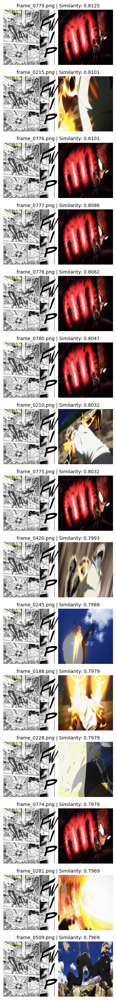

In [9]:
clip_match_and_show_grid(
    manga_folder="/content/one",
    frame_folder="/content/frames",
    top_k=15
)


In [29]:
!rm -rf /content/solo_vid_frames
import os
os.makedirs("solo_vid_frames", exist_ok=True)

!ffmpeg -i solo_video.mp4 -vf fps=2 /content/solo_vid_frames/frame_%04d.png

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

🔍 Running CLIP similarity check...

🖼️ Matching manga page: page_041.jpg


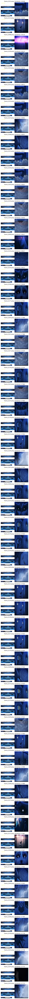

In [28]:
clip_match_and_show_grid(
    manga_folder="/content/solo_level_6",
    frame_folder="/content/solo_vid_frames",
    top_k=60
)

In [36]:
import torch
# from dinov2.models import vision_transformer as vits
from torchvision import transforms
from PIL import Image

device = "cuda" if torch.cuda.is_available() else "cpu"

# Load DINOv2 Base
# dino_model = vits.vit_base()
# state_dict = torch.hub.load_state_dict_from_url(
#     "https://dl.fbaipublicfiles.com/dinov2/dinov2_vitb14_pretrain.pth",
#     map_location=device
# )
# dino_model.load_state_dict(state_dict)
# dino_model.eval().to(device)
dinov2_vitb14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vitb14')
dino_model = dinov2_vitb14
dino_model.eval().cuda()
# DINO transform
dino_preprocess = transforms.Compose([
    transforms.Resize((518, 518)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])
import os
import matplotlib.pyplot as plt
from PIL import ImageDraw
from io import BytesIO

def dino_match_and_show_grid(manga_folder, frame_folder, top_k=15, target_page=None):
    print("🔍 Running DINOv2 similarity check...")

    # Get all files
    manga_images = sorted([os.path.join(manga_folder, f) for f in os.listdir(manga_folder) if f.endswith(('.png', '.jpg', '.jpeg'))])
    frame_images = sorted([os.path.join(frame_folder, f) for f in os.listdir(frame_folder) if f.endswith(('.png', '.jpg', '.jpeg'))])

    # Use only 1 manga page for now
    if target_page:
        manga_images = [target_page]
    else:
        manga_images = [manga_images[40]]

    for manga_img_path in manga_images:
        print(f"\n🖼️ Matching manga page: {os.path.basename(manga_img_path)}")

        # Encode the panel
        panel_tensor = dino_preprocess(Image.open(manga_img_path).convert("RGB")).unsqueeze(0).to(device)
        with torch.no_grad():
            panel_feat = dino_model.forward_features(panel_tensor)["x_norm_clstoken"]

        similarities = []
        for frame_path in frame_images:
            try:
                frame_tensor = dino_preprocess(Image.open(frame_path).convert("RGB")).unsqueeze(0).to(device)
                with torch.no_grad():
                    frame_feat = dino_model.forward_features(frame_tensor)["x_norm_clstoken"]

                score = torch.nn.functional.cosine_similarity(panel_feat, frame_feat).item()
                similarities.append((frame_path, score))
            except Exception as e:
                print(f"⚠️ Skipped {frame_path} due to error: {e}")

        # Sort top matches
        top_matches = sorted(similarities, key=lambda x: -x[1])[:top_k]

        # Grid Display
        plt.figure(figsize=(18, 2 * top_k))
        for i, (match_path, score) in enumerate(top_matches):
            manga_disp = Image.open(manga_img_path).resize((224, 224))
            frame_disp = Image.open(match_path).resize((224, 224))

            combined = Image.new('RGB', (448, 224))
            combined.paste(manga_disp, (0, 0))
            combined.paste(frame_disp, (224, 0))

            draw = ImageDraw.Draw(combined)
            draw.text((10, 5), f"Score: {score:.4f}", fill=(255, 255, 0))

            plt.subplot(top_k, 1, i + 1)
            plt.imshow(combined)
            plt.axis("off")
            plt.title(f"{os.path.basename(match_path)} | Similarity: {score:.4f}", fontsize=10)

        plt.tight_layout()
        plt.show()


Using cache found in /root/.cache/torch/hub/facebookresearch_dinov2_main


🔍 Running DINOv2 similarity check...

🖼️ Matching manga page: page_041.jpg


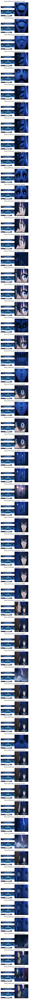

In [37]:
dino_match_and_show_grid(
    manga_folder="/content/solo_level_6",
    frame_folder="/content/solo_vid_frames",
    top_k=60
)
